<a href="https://colab.research.google.com/github/alamwasim/solar-irradiation-prediction/blob/2_years_data_training/Solar_Irradiation_Prediction_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installing pycaret libraires and pandas profiling incase if not available

In [15]:
# !pip install pycaret

In [3]:
# !pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [4]:
# Reference https://pandas-profiling.github.io/pandas-profiling/docs/master/rtd/pages/getting_started.html
# import sys
# !{sys.executable} -m pip install -U pandas-profiling[notebook]
# !jupyter nbextension enable --py widgetsnbextension

In [5]:
from pandas_profiling import ProfileReport

In [6]:
import pandas as pd
import numpy as np
import pandas_profiling 
import scipy as sp
from scipy import stats
import matplotlib.pyplot as plt
import matplotlib.dates as dates
import seaborn as sns
from pycaret.regression import *

# Importing Data from locally uploaded csv file

In [7]:
data=pd.read_csv('/content/rajasthan_weather_data.csv')

In [8]:
data.head()

,PeriodEnd,PeriodStart,Temperature,CloudOpacity,PrecipitableWater,Relative Humidity,Snow depth,Pressure,Wind direction,Wind speed,Zenith,Short-wave irradiation
0,2017-12-31T02:00:00Z,2017-12-31T01:00:00Z,9.4,0.0,11.0,79.4,0,973.0,63,2.5,94,2
1,2017-12-31T03:00:00Z,2017-12-31T02:00:00Z,10.3,43.1,10.9,77.3,0,973.5,70,2.5,82,44
2,2017-12-31T04:00:00Z,2017-12-31T03:00:00Z,12.3,34.4,10.8,68.6,0,973.7,77,2.2,71,168
3,2017-12-31T05:00:00Z,2017-12-31T04:00:00Z,15.5,23.6,10.9,55.8,0,973.9,85,1.8,62,325
4,2017-12-31T06:00:00Z,2017-12-31T05:00:00Z,18.7,0.2,10.9,45.7,0,974.1,99,1.4,55,547


In [9]:
data.shape

(26349, 12)

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26349 entries, 0 to 26348
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   PeriodEnd               26349 non-null  object 
 1   PeriodStart             26349 non-null  object 
 2   Temperature             26349 non-null  float64
 3   CloudOpacity            26349 non-null  float64
 4   PrecipitableWater       26349 non-null  float64
 5   Relative Humidity       26349 non-null  float64
 6   Snow depth              26349 non-null  int64  
 7   Pressure                26349 non-null  float64
 8   Wind direction          26349 non-null  int64  
 9   Wind speed              26349 non-null  float64
 10  Zenith                  26349 non-null  int64  
 11  Short-wave irradiation  26349 non-null  int64  
dtypes: float64(6), int64(4), object(2)
memory usage: 2.4+ MB


In [11]:
data.PeriodStart=pd.to_datetime(data['PeriodStart'])

# Extracting day,month,year frm date

In [12]:
data['hour']=data['PeriodStart'].apply(lambda x: x.hour)
data['month']=data['PeriodStart'].apply(lambda x: x.month)
data['week']=data['PeriodStart'].apply(lambda x: x.week)

In [13]:
data['Date_timestamp']=data.PeriodStart
data.set_index('Date_timestamp',inplace=True)

In [14]:
data.head()

,PeriodEnd,PeriodStart,Temperature,CloudOpacity,PrecipitableWater,Relative Humidity,Snow depth,Pressure,Wind direction,Wind speed,Zenith,Short-wave irradiation,hour,month,week
Date_timestamp,,,,,,,,,,,,,,,
2017-12-31 01:00:00+00:00,2017-12-31T02:00:00Z,2017-12-31 01:00:00+00:00,9.4,0.0,11.0,79.4,0,973.0,63,2.5,94,2,1,12,52
2017-12-31 02:00:00+00:00,2017-12-31T03:00:00Z,2017-12-31 02:00:00+00:00,10.3,43.1,10.9,77.3,0,973.5,70,2.5,82,44,2,12,52
2017-12-31 03:00:00+00:00,2017-12-31T04:00:00Z,2017-12-31 03:00:00+00:00,12.3,34.4,10.8,68.6,0,973.7,77,2.2,71,168,3,12,52
2017-12-31 04:00:00+00:00,2017-12-31T05:00:00Z,2017-12-31 04:00:00+00:00,15.5,23.6,10.9,55.8,0,973.9,85,1.8,62,325,4,12,52
2017-12-31 05:00:00+00:00,2017-12-31T06:00:00Z,2017-12-31 05:00:00+00:00,18.7,0.2,10.9,45.7,0,974.1,99,1.4,55,547,5,12,52


# Profile Report

In [ ]:
profile = ProfileReport(data, title="Pandas Profiling Report")

In [ ]:
profile.to_widgets()

Summarize dataset:   0%|          | 0/29 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_notebook_iframe()

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_file("pandas_profile_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# Splitting the data into train and test and defining sel_col

In [37]:
data.rename(columns={"Short-wave irradiation":"Short_wave_irradiation","Relative Humidity":"Relative_Humidity","Wind direction":"Wind_direction","Wind speed":"Wind_speed"},inplace=True)

In [48]:
print("Max and Min Date in whole data:",data.PeriodStart.max(),data.PeriodStart.min())
train=data.loc[data.PeriodStart<='2019-12-01']
test=data.loc[data.PeriodStart>'2019-12-01']
print("Max and Min Date in train data:",train.PeriodStart.max(),train.PeriodStart.min())
print("Max and Min Date in test data:",test.PeriodStart.max(),test.PeriodStart.min())

Max and Min Date in whole data: 2021-01-01 21:00:00+00:00 2017-12-31 01:00:00+00:00
Max and Min Date in train data: 2019-12-01 00:00:00+00:00 2017-12-31 01:00:00+00:00
Max and Min Date in test data: 2021-01-01 21:00:00+00:00 2019-12-01 01:00:00+00:00


In [49]:
train.columns

Index(['PeriodEnd', 'PeriodStart', 'Temperature', 'CloudOpacity',
       'PrecipitableWater', 'Relative_Humidity', 'Snow depth', 'Pressure',
       'Wind_direction', 'Wind_speed', 'Zenith', 'Short_wave_irradiation',
       'hour', 'month', 'week'],
      dtype='object')

In [42]:
sel_col=['Temperature', 'CloudOpacity',
       'PrecipitableWater', 'Relative_Humidity', 'Pressure',
       'Wind_direction', 'Wind_speed', 'Zenith',
       'hour', 'month', 'week','Short_wave_irradiation']

# Regression Analysis and Hetroskedaticity Test

In [43]:
df=data[sel_col]

In [25]:
df.columns

Index(['Temperature', 'CloudOpacity', 'PrecipitableWater', 'Relative_Humidity',
       'Pressure', 'Wind_direction', 'Wind_speed', 'Zenith', 'hour', 'month',
       'week', 'Short_wave_irradiation'],
      dtype='object')

In [26]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import het_breuschpagan
from statsmodels.stats.diagnostic import het_white

In [27]:
# Formula for linear regression
f=""
for x in df.columns[:-1]:
  f=f+str(x+"+")
f=df.columns[-1]+"~"+f[:-1]
print(f)
# reference for formula use:  https://patsy.readthedocs.io/en/latest/formulas.html

Short_wave_irradiation~Temperature+CloudOpacity+PrecipitableWater+Relative_Humidity+Pressure+Wind_direction+Wind_speed+Zenith+hour+month+week


In [28]:
f="Short_wave_irradiation~(Temperature+CloudOpacity+PrecipitableWater+Relative_Humidity+Pressure+Wind_direction+Wind_speed+Zenith+hour+month+week)**2"
ols_result=ols(formula=f,data=df).fit()
print(ols_result.summary())
# Reference for understanding below ols summary
# https://medium.com/@jyotiyadav99111/statistics-how-should-i-interpret-results-of-ols-3bde1ebeec01#:~:text=Prob(F%2DStatistic)%3A%20This,overall%20significance%20of%20the%20regression.&text=It%20penalizes%20the%20errors%20mode,AIC%20implies%20a%20better%20model.

                              OLS Regression Results                              
Dep. Variable:     Short_wave_irradiation   R-squared:                       0.948
Model:                                OLS   Adj. R-squared:                  0.948
Method:                     Least Squares   F-statistic:                     7284.
Date:                    Sat, 20 Feb 2021   Prob (F-statistic):               0.00
Time:                            14:32:52   Log-Likelihood:            -1.4750e+05
No. Observations:                   26349   AIC:                         2.951e+05
Df Residuals:                       26282   BIC:                         2.957e+05
Df Model:                              66                                         
Covariance Type:                nonrobust                                         
                                          coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

In [32]:
# white_test = het_white(ols_result.resid,  ols_result.model.exog)
white_test ==[0,0,0,0]# Initiallize to zero when white test take huge time
bp_test = het_breuschpagan(ols_result.resid,df[df.columns[:-1]])
labels = ['LM Statistic', 'LM-Test p-value', 'F-Statistic', 'F-Test p-value']
hetroskedasticty_test=pd.DataFrame(data={"Breusch-Pagan Test":list(bp_test),"White test":list(white_test)},index=labels)
hetroskedasticty_test
# Heteroskedasticity is indicated if p <0.05, so according to these tests, this model is heteroskedastic.

,Breusch-Pagan Test,White test
LM Statistic,10298.564782,0
LM-Test p-value,0.000000,0
F-Statistic,1536.314043,0
F-Test p-value,0.000000,0


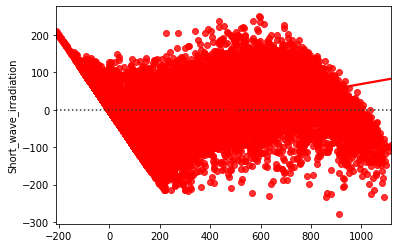

In [33]:
y_pred=ols_result.predict(df[df.columns[:-1]])
y_test=df[df.columns[-1]]
residuals=y_test-y_pred
sns.residplot(x=y_pred, y=y_test, lowess=True, color="r")

# Pycaret Pipeline
<li> No sort of normalization and transformation is done
<li> date features are treated as numerical only and not as date type

In [54]:
train[sel_col].head()

,Temperature,CloudOpacity,PrecipitableWater,Relative_Humidity,Pressure,Wind_direction,Wind_speed,Zenith,hour,month,week,Short_wave_irradiation
Date_timestamp,,,,,,,,,,,,
2017-12-31 01:00:00+00:00,9.4,0.0,11.0,79.4,973.0,63,2.5,94,1,12,52,2
2017-12-31 02:00:00+00:00,10.3,43.1,10.9,77.3,973.5,70,2.5,82,2,12,52,44
2017-12-31 03:00:00+00:00,12.3,34.4,10.8,68.6,973.7,77,2.2,71,3,12,52,168
2017-12-31 04:00:00+00:00,15.5,23.6,10.9,55.8,973.9,85,1.8,62,4,12,52,325
2017-12-31 05:00:00+00:00,18.7,0.2,10.9,45.7,974.1,99,1.4,55,5,12,52,547


In [111]:
reg1 = setup(train[sel_col], target = 'Short_wave_irradiation',
             numeric_features=sel_col[:-1],
        session_id = 123, silent = True) #silent is set to True for unattended run during kernel execution

,Description,Value
0,session_id,123
1,Target,Short_wave_irradiation
2,Original Data,"(16800, 12)"
3,Missing Values,False
4,Numeric Features,11
5,Categorical Features,0
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(11759, 11)"


In [55]:
top5=compare_models( n_select = 5,fold = 10,  round = 4,  sort = 'R2', turbo = True)
top5_summary=pull()
top5_model_name=top5_summary.index.to_list()[:5]

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,7.1718,175.9663,13.2571,0.9979,0.5024,0.1411,4.676
lightgbm,Light Gradient Boosting Machine,7.8984,229.9768,15.1478,0.9972,0.2431,0.1219,0.196
xgboost,Extreme Gradient Boosting,8.1583,233.4068,15.2654,0.9972,0.4327,0.1275,4.955
et,Extra Trees Regressor,8.0946,274.4621,16.5593,0.9967,0.0924,0.0865,1.740
rf,Random Forest Regressor,8.8026,315.1809,17.7405,0.9962,0.0962,0.0917,3.727
gbr,Gradient Boosting Regressor,11.3641,408.7340,20.1983,0.9950,0.5660,0.1693,1.446
mlp,MLP Regressor,13.6043,514.5225,21.7777,0.9937,1.0094,0.3668,11.718
dt,Decision Tree Regressor,12.7845,679.4583,26.0439,0.9917,0.1355,0.1254,0.071
knn,K Neighbors Regressor,19.4160,1231.9436,35.0603,0.9850,0.4984,0.5910,0.359
ada,AdaBoost Regressor,28.6018,1429.7385,37.7944,0.9826,1.9732,0.8677,0.782


 ## Feature Importance
 **<li>feature importance by top model marks Zenith and CloudOpacity as most importnant
 <li>Other features by rf,xgboost and et are of zero importance**

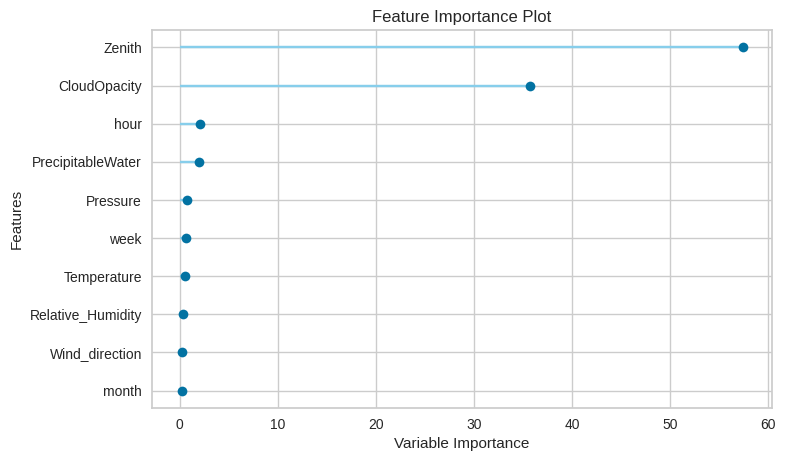

In [72]:
#catboost feature imortance
plot_model(top5[0], plot = 'feature')

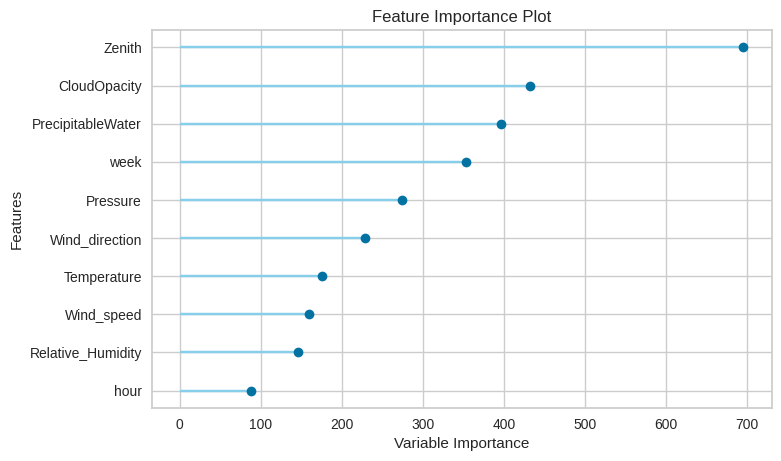

In [74]:
#lightgbm feature imortance
plot_model(top5[1], plot = 'feature')

## Feature seletion and ranking with recursive feature elimination(RFE)
lightgbm model gives optimum 4 feature to be used **[CloudOpacity PrecipitableWater	Zenith week]**

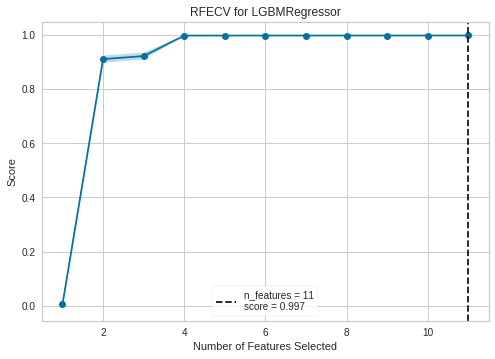

In [76]:
plot_model(top5[1], plot = 'rfe')

In [94]:
from sklearn.feature_selection import RFE
selector = RFE(top5[1], n_features_to_select=4, step=1)
selector = selector.fit(train[sel_col[:-1]], train[sel_col[-1]])
pd.DataFrame(data={"columns":sel_col[:-1],"to_use":selector.support_}).sort_values("to_use",ascending=False).reset_index(drop=True)

,columns,to_use
0,CloudOpacity,True
1,PrecipitableWater,True
2,Zenith,True
3,week,True
4,Temperature,False
5,Relative_Humidity,False
6,Pressure,False
7,Wind_direction,False
8,Wind_speed,False
9,hour,False


## PCA Analysis 
<li> Plotting cumulative variance explained by no of components
<li> Keeping 6 components explain 90% variance in dataset

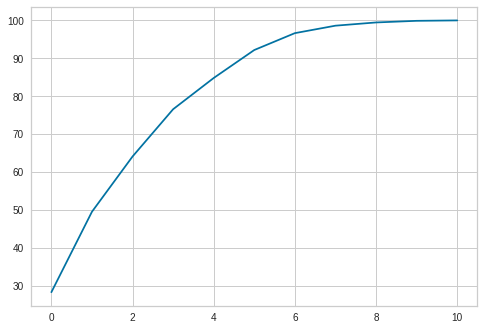

In [70]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
X = scale(train[sel_col[:-1]].values)
pca = PCA()
pca.fit(X)
#Cumulative Variance explains
var1=np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100)
plt.plot(var1)

## Evaluating LightGBM model and visualizing Manifold Leraning Graph

In [96]:
evaluate_model(top5[1])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [113]:
# !pip install shap
dt = create_model('dt')
evaluate_model(dt)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,13.2406,704.0604,26.5341,0.9919,0.1268,0.1187
1,12.6386,679.0910,26.0594,0.9921,0.1418,0.1199
2,13.3878,703.7755,26.5288,0.9916,0.1305,0.1236
3,12.7781,680.1777,26.0802,0.9915,0.1530,0.1357
4,11.8988,607.7798,24.6532,0.9924,0.1315,0.1163
5,13.5128,730.1777,27.0218,0.9908,0.1411,0.1309
6,12.9226,730.5604,27.0289,0.9910,0.1247,0.1250
7,13.7798,758.4498,27.5400,0.9907,0.1499,0.1415
8,11.8554,578.8520,24.0593,0.9929,0.1346,0.1202
9,11.8306,621.6587,24.9331,0.9925,0.1209,0.1224


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

## Testing All trained model on Test data set

In [135]:
pred_eval=pd.DataFrame()
for model,name in zip(top5,top5_model_name):
  pred=predict_model(model,test[sel_col])
  pred_eval[name]=get_metrics()['Score Function'].apply(lambda x :x(pred['Short_wave_irradiation'],pred['Label']))
pred_eval

,catboost,lightgbm,xgboost,et,rf
ID,,,,,
mae,11.086971,10.938389,12.070881,9.993757,10.446266
mse,403.186295,434.407114,484.661740,398.653013,423.093749
rmse,403.186295,434.407114,484.661740,398.653013,423.093749
r2,0.995079,0.994698,0.994085,0.995134,0.994836
rmsle,0.749947,0.416112,0.727183,0.136241,0.119110
mape,0.218140,0.152180,0.183174,0.118166,0.113469


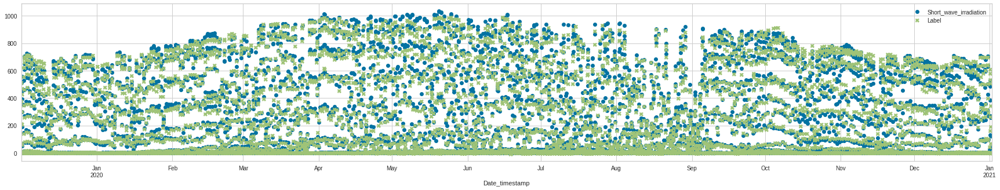

In [141]:
predict_model(top5[1],test[sel_col])[['Short_wave_irradiation','Label']].plot(style=['o','X'],figsize=[30,5])